<a href="https://colab.research.google.com/github/annulet/CNN_NVIDIA/blob/master/hw_8_Gegeration_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Реализовать синтезирование лиц из LFW с помощью DCGAN.
 Библиотеки: [Python, Tensorflow]

## Переключение версии TensorFlow

In [0]:
%tensorflow_version 2.x

In [0]:
import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf
import tensorflow_datasets as tfds

## Загрузка и подготовка датасета LFW

In [3]:
train_ds, ds_info = tfds.load(
    'lfw',
    with_info=True,
    split='train'
)

Shuffling and writing examples to /root/tensorflow_datasets/lfw/0.1.0.incomplete7DQD0E/lfw-train.tfrecord



Dataset lfw downloaded and prepared to /root/tensorflow_datasets/lfw/0.1.0. Subsequent calls will reuse this data.


In [4]:
ds_info

tfds.core.DatasetInfo(
    name='lfw',
    version=0.1.0,
    description='Labeled Faces in the Wild:
        A Database for Studying Face Recognition in
        Unconstrained Environments',
    homepage='http://vis-www.cs.umass.edu/lfw',
    features=FeaturesDict({
        'image': Image(shape=(250, 250, 3), dtype=tf.uint8),
        'label': Text(shape=(), dtype=tf.string),
    }),
    total_num_examples=13233,
    splits={
        'train': 13233,
    },
    supervised_keys=('label', 'image'),
    citation="""@TechReport{LFWTech,
        author = {Gary B. Huang and Manu Ramesh and Tamara Berg and Erik Learned-Miller},
        title = {Labeled Faces in the Wild: A Database for Studying Face Recognition in Unconstrained Environments},
        institution = {University of Massachusetts, Amherst},
        year = 2007,
        number = {07-49},
        month = {October}
    }""",
    redistribution_info=,
)

## Визуализация датасета LFW

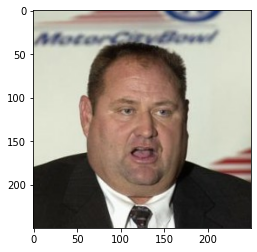

In [5]:
for example in train_ds.take(1):  # Only take a single example
    image = example['image']
    plt.imshow(image.numpy().astype(np.float32)/255)

In [0]:
train_x = [x['image'].numpy().reshape(250, 250, 3) for x in train_ds]

In [7]:
train_x[0].shape

(250, 250, 3)

In [8]:
len(train_x)

13233

##Подготовка датасета

In [0]:
INPUT_DIM = 100
NUM_EPOCHS = 50
HALF_BATCH_SIZE = 16
BATCH_SIZE = HALF_BATCH_SIZE * 2
LEARNING_RATE = 0.0002

In [0]:
def prepare(img):
  img = tf.cast(img, tf.float32) / 255.
  return img

In [0]:
train_ds = tf.data.Dataset.from_tensor_slices(train_x)
train_ds = train_ds.shuffle(buffer_size=len(train_x))
train_ds = train_ds.map(prepare)
train_ds = train_ds.repeat(NUM_EPOCHS)
train_ds = train_ds.batch(HALF_BATCH_SIZE, drop_remainder=True)

In [12]:
train_ds

<BatchDataset shapes: (16, 250, 250, 3), types: tf.float32>

In [0]:
optimizer = tf.keras.optimizers.Adam(LEARNING_RATE)
sigmoid_cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

## Deep Convolutional GAN (DCGAN)

In [0]:
generator = tf.keras.Sequential([
    tf.keras.layers.Dense(256*5*5, activation='relu'),
    tf.keras.layers.Reshape((5, 5, 256)),
    tf.keras.layers.UpSampling2D((5, 5)),    
    tf.keras.layers.Conv2D(256, (5, 5), padding='same'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.ReLU(),    
    tf.keras.layers.UpSampling2D((5, 5)),    
    tf.keras.layers.Conv2D(128, (5, 5), padding='same'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.ReLU(),  
    tf.keras.layers.UpSampling2D((2, 2)),    
    tf.keras.layers.Conv2D(64, (5, 5), padding='same'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.ReLU(),   
    tf.keras.layers.Conv2D(3, (5, 5), padding='same', activation='tanh'),
])

In [0]:
noise = np.random.normal(0, 1, (HALF_BATCH_SIZE, INPUT_DIM)).astype(np.float32)
syntetic_images = generator.predict(noise)

In [16]:
syntetic_images.shape

(16, 250, 250, 3)

In [0]:
# def plot_pics(samples):
#     fig = plt.figure(figsize=(20, 20))
#     num = samples.shape[0]
#     for j in range(num):
#         ax = fig.add_subplot(8, 8, j+1)
#         ax.imshow(samples[j, ...].reshape(250, 250, 3))
#         plt.xticks([]), plt.yticks([])
#     plt.show()

In [0]:
def plot_pics(samples):
    fig = plt.figure(figsize=(20, 20))
    num = samples.shape[0]
    for j in range(num):
        ax = fig.add_subplot(8, 8, j+1)
        img = np.abs(samples[j, ...])
        ax.imshow(img)
        plt.xticks([]), plt.yticks([])
    plt.show()

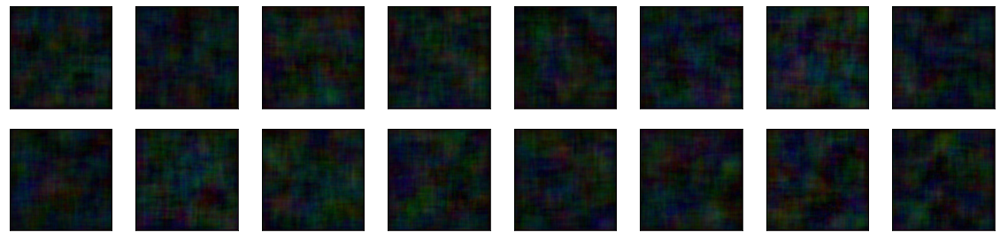

In [19]:
plot_pics(syntetic_images)

In [0]:
discriminator = tf.keras.Sequential([
    tf.keras.layers.Conv2D(64, (3, 3), strides=(2, 2), padding='same'),
    tf.keras.layers.LeakyReLU(0.2),
    tf.keras.layers.Dropout(0.25),    
    tf.keras.layers.Conv2D(128, kernel_size=3, strides=(2, 2), padding='same'),
    tf.keras.layers.ZeroPadding2D(padding=((0, 1), (0, 1))),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.LeakyReLU(alpha=0.2),
    tf.keras.layers.Dropout(0.25),
    tf.keras.layers.Conv2D(256, kernel_size=3, strides=(2, 2), padding='same'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.LeakyReLU(alpha=0.2),
    tf.keras.layers.Dropout(0.25),
    tf.keras.layers.Conv2D(512, kernel_size=3, strides=(1, 1), padding='same'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.LeakyReLU(alpha=0.2),
    tf.keras.layers.Dropout(0.25),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(1),
])

[Step  0] D Loss: 1.0893; G Loss: 0.5472


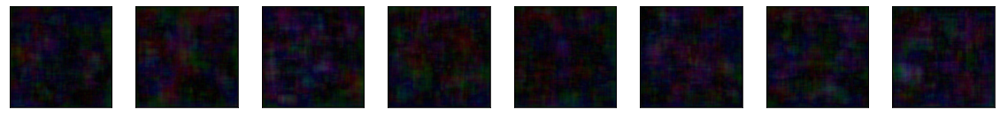

[Step 500] D Loss: 5.8325; G Loss: 19.2102


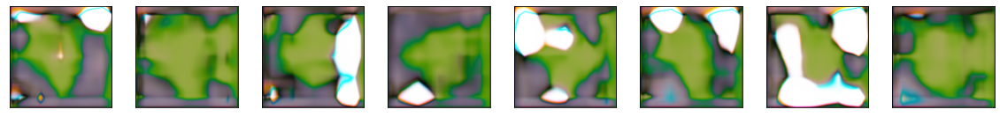

[Step 1000] D Loss: 5.7376; G Loss: 28.3112


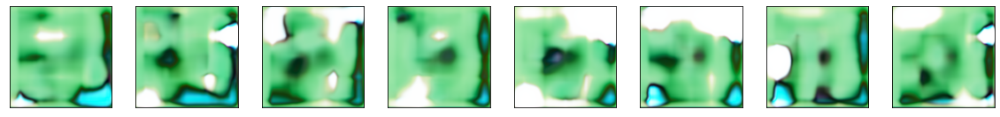

[Step 1500] D Loss: 3.4014; G Loss: 72.1697


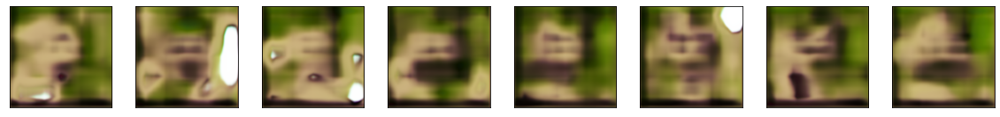

[Step 2000] D Loss: 10.1476; G Loss: 56.4191


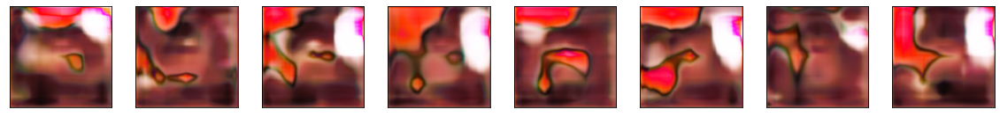

[Step 2500] D Loss: 7.0331; G Loss: 1.1666


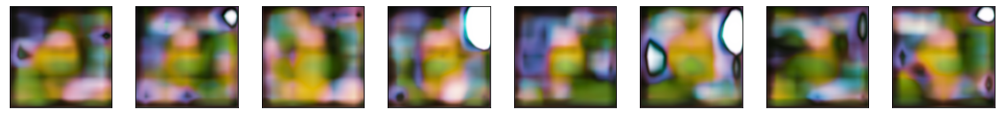

[Step 3000] D Loss: 11.9074; G Loss: 17.1451


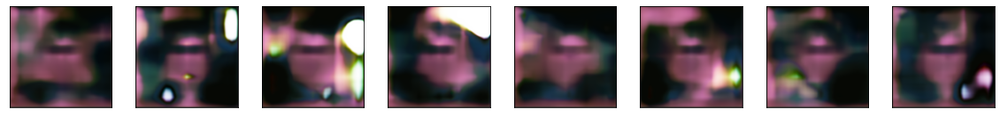

[Step 3500] D Loss: 1.2741; G Loss: 43.5864


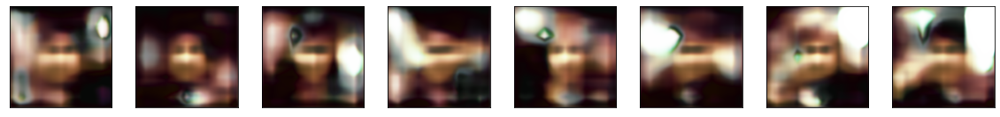

[Step 4000] D Loss: 11.3733; G Loss: 88.6666


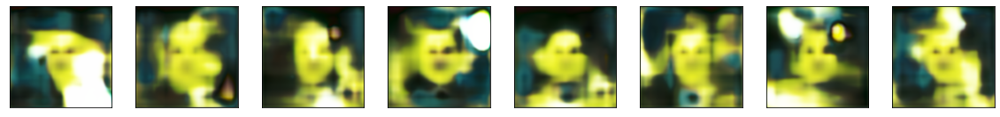

[Step 4500] D Loss: 4.2594; G Loss: 35.9376


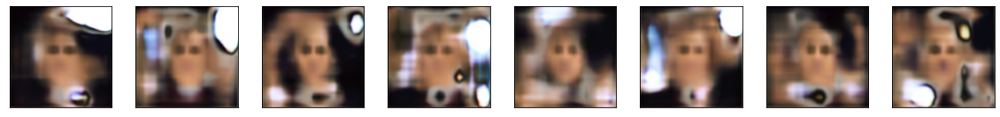

[Step 5000] D Loss: 0.2383; G Loss: 25.9319


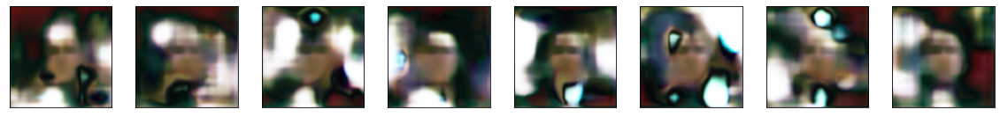

[Step 5500] D Loss: 2.7525; G Loss: 27.4620


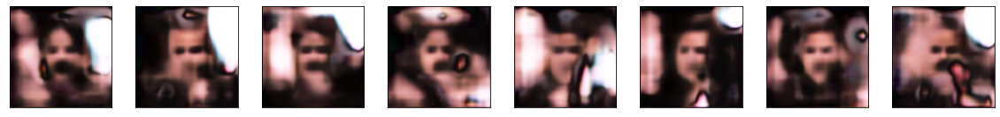

[Step 6000] D Loss: 2.2680; G Loss: 16.6455


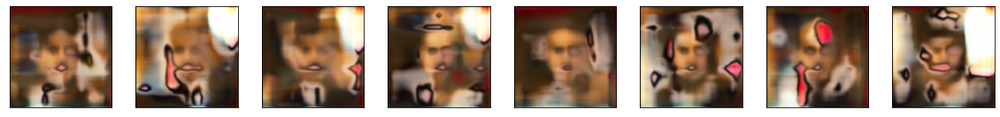

[Step 6500] D Loss: 1.0528; G Loss: 44.9601


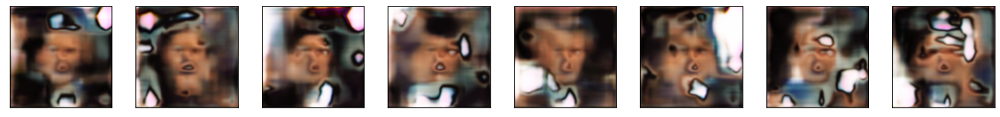

[Step 7000] D Loss: 0.9921; G Loss: 31.3884


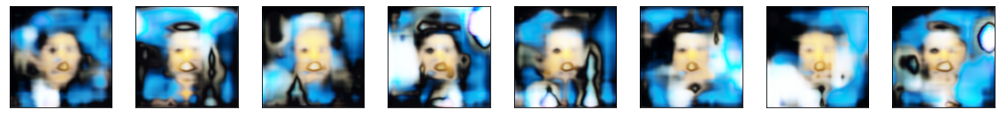

[Step 7500] D Loss: 9.4823; G Loss: 75.2143


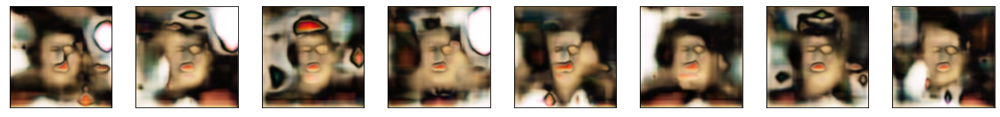

[Step 8000] D Loss: 4.8198; G Loss: 61.8120


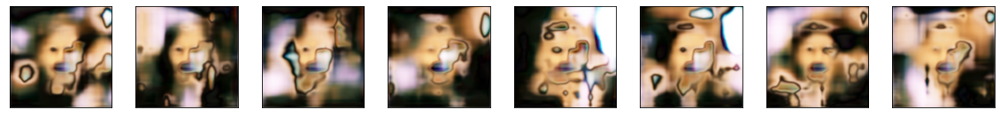

[Step 8500] D Loss: 0.7665; G Loss: 38.2862


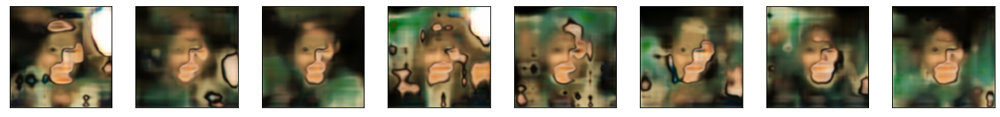

[Step 9000] D Loss: 2.5353; G Loss: 16.2155


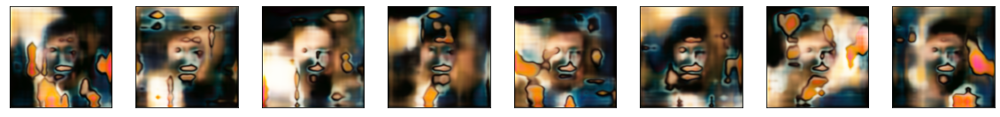

[Step 9500] D Loss: 0.0403; G Loss: 13.7868


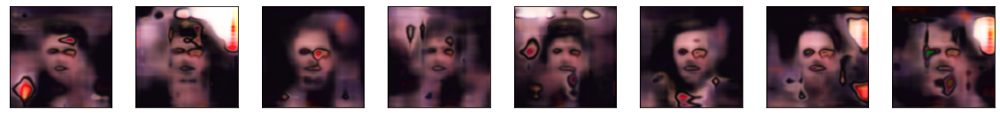

[Step 10000] D Loss: 0.5647; G Loss: 41.0237


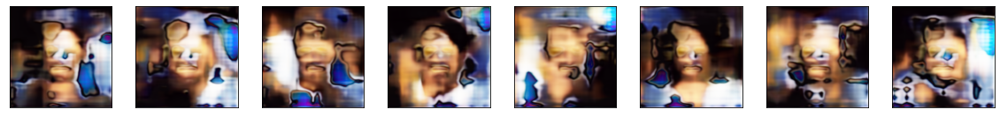

[Step 10500] D Loss: 1.6647; G Loss: 12.9876


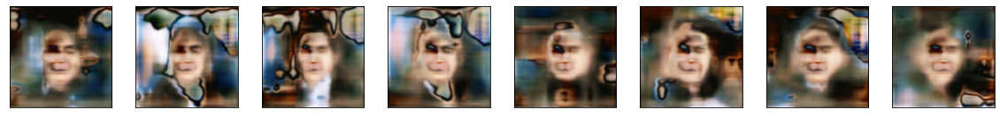

[Step 11000] D Loss: 1.2274; G Loss: 14.2590


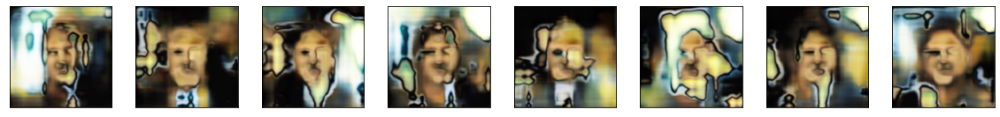

[Step 11500] D Loss: 1.4738; G Loss: 8.1717


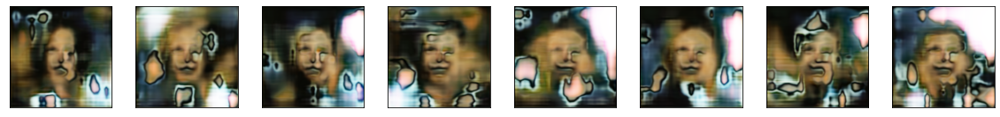

[Step 12000] D Loss: 14.3052; G Loss: 0.8163


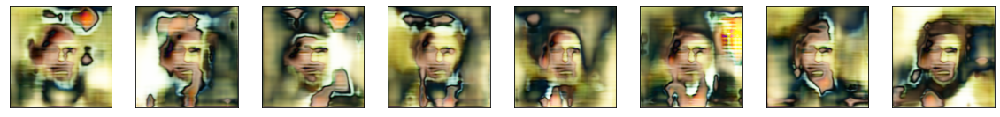

[Step 12500] D Loss: 0.5170; G Loss: 19.6587


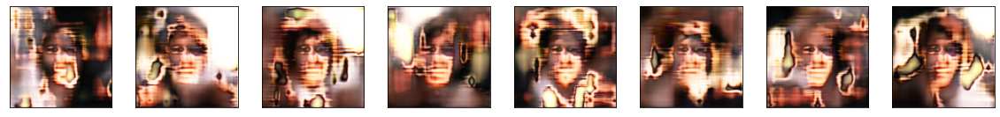

[Step 13000] D Loss: 2.4422; G Loss: 40.1165


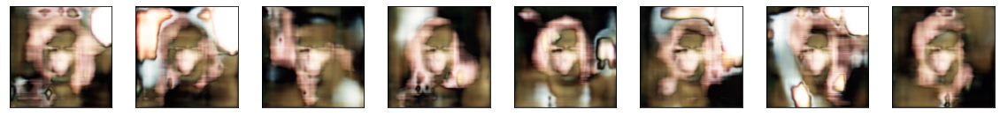

[Step 13500] D Loss: 0.3120; G Loss: 12.0965


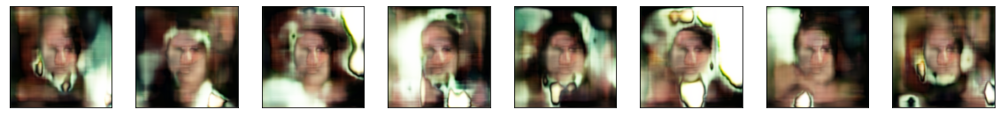

[Step 14000] D Loss: 1.9331; G Loss: 74.4671


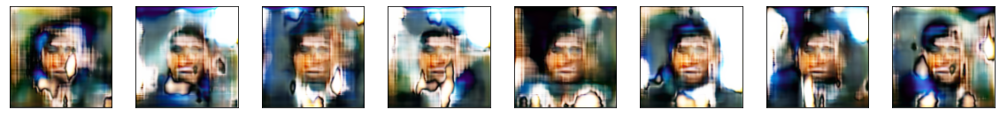

[Step 14500] D Loss: 1.6526; G Loss: 10.1542


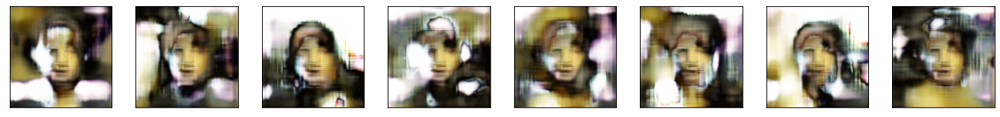

[Step 15000] D Loss: 0.0541; G Loss: 5.3315


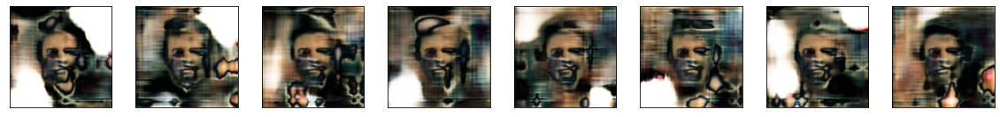

[Step 15500] D Loss: 0.5292; G Loss: 13.9682


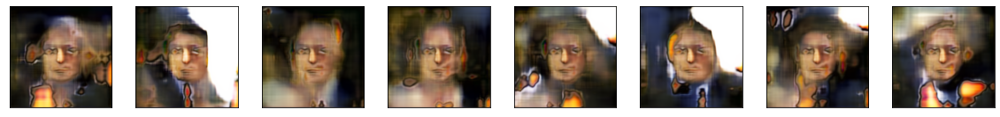

[Step 16000] D Loss: 1.5012; G Loss: 25.8549


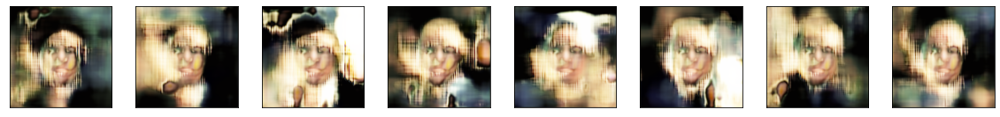

[Step 16500] D Loss: 0.2817; G Loss: 6.2152


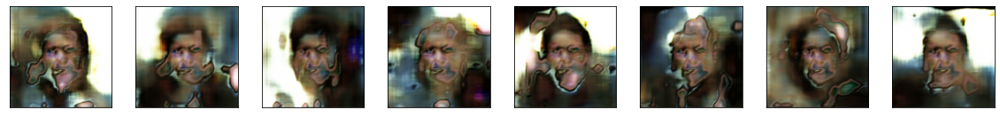

[Step 17000] D Loss: 0.2597; G Loss: 27.0909


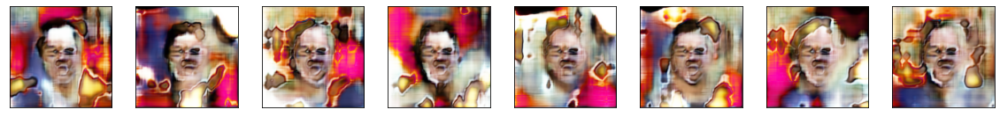

[Step 17500] D Loss: 0.0000; G Loss: 35.1857


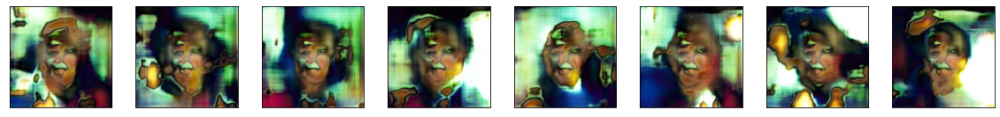

[Step 18000] D Loss: 0.4957; G Loss: 21.0746


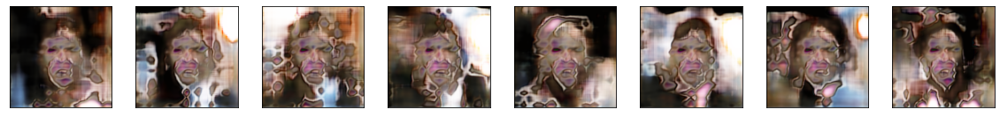

[Step 18500] D Loss: 0.3648; G Loss: 31.2899


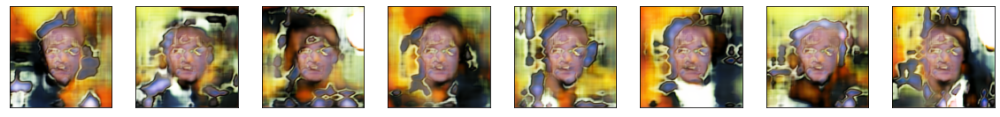

[Step 19000] D Loss: 0.7031; G Loss: 26.4413


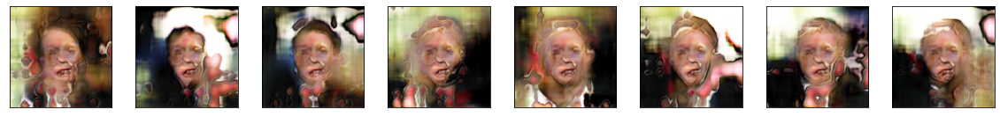

[Step 19500] D Loss: 2.0890; G Loss: 4.4402


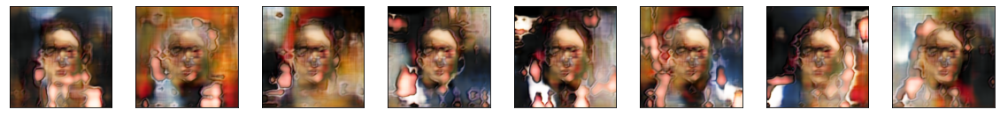

[Step 20000] D Loss: 0.0064; G Loss: 37.8813


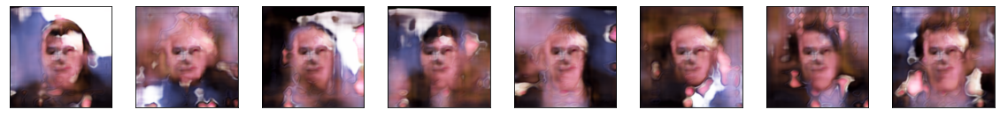

[Step 20500] D Loss: 1.2283; G Loss: 38.4476


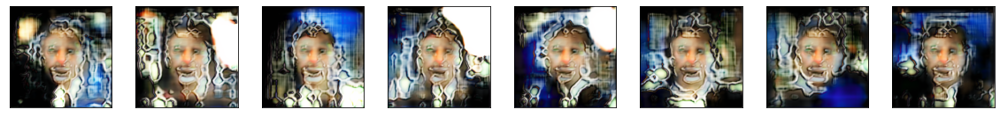

[Step 21000] D Loss: 0.0000; G Loss: 22.6137


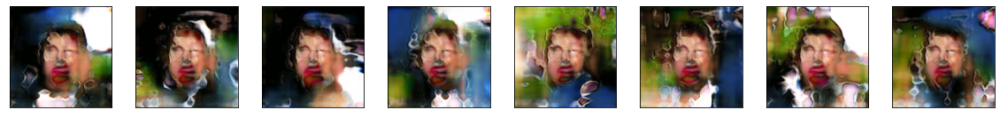

[Step 21500] D Loss: 0.0557; G Loss: 56.8042


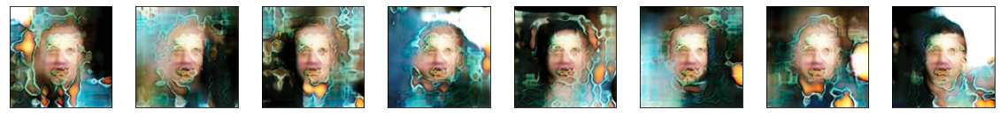

[Step 22000] D Loss: 1.5624; G Loss: 4.5580


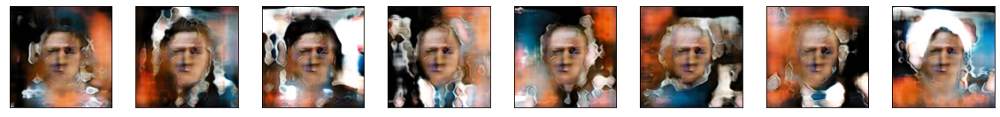

[Step 22500] D Loss: 0.0213; G Loss: 10.3256


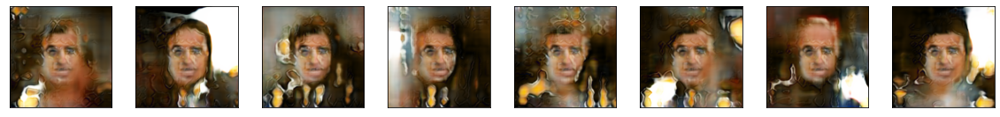

[Step 23000] D Loss: 0.0547; G Loss: 9.0707


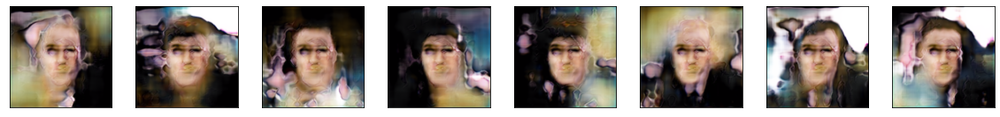

[Step 23500] D Loss: 0.0043; G Loss: 42.5255


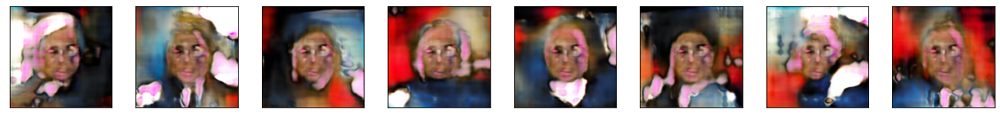

[Step 24000] D Loss: 0.9458; G Loss: 10.3113


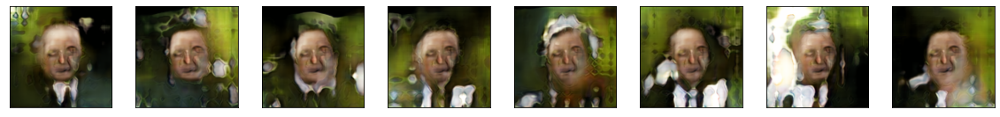

[Step 24500] D Loss: 0.0003; G Loss: 32.5628


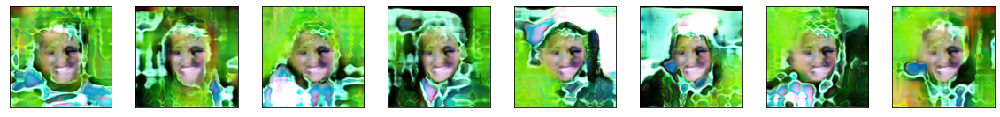

[Step 25000] D Loss: 0.0047; G Loss: 9.6378


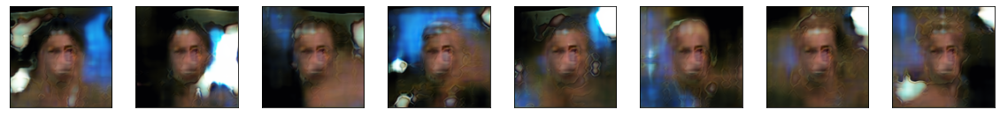

[Step 25500] D Loss: 0.1957; G Loss: 23.5479


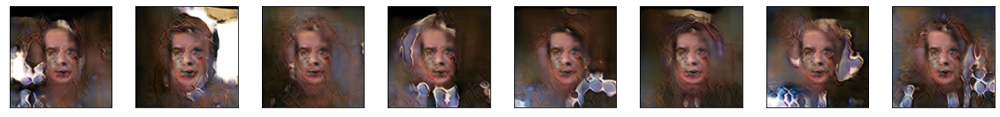

[Step 26000] D Loss: 0.0876; G Loss: 22.6262


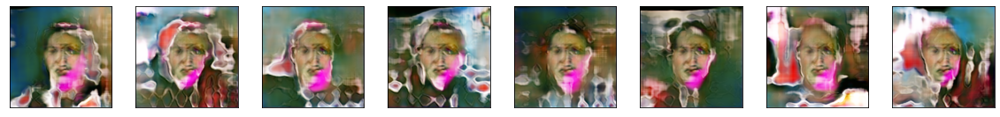

[Step 26500] D Loss: 0.3391; G Loss: 1.7300


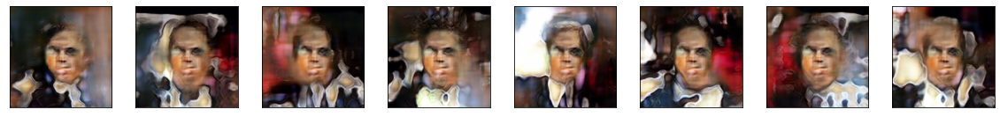

[Step 27000] D Loss: 0.3064; G Loss: 0.3032


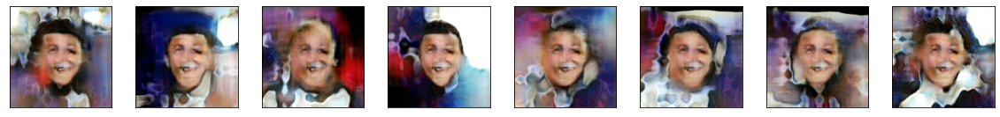

[Step 27500] D Loss: 0.5188; G Loss: 1.1104


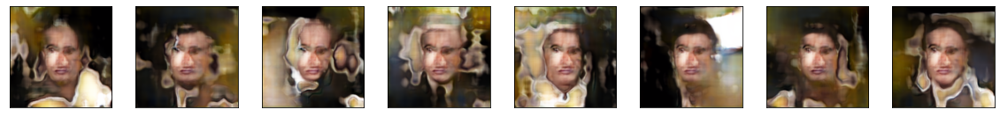

[Step 28000] D Loss: 0.9232; G Loss: 20.6169


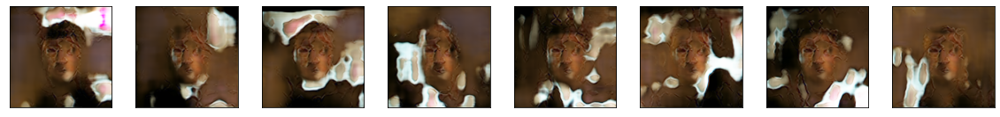

[Step 28500] D Loss: 0.2049; G Loss: 1.8171


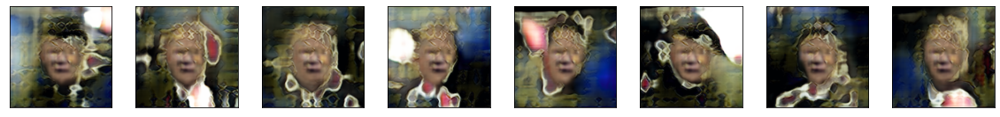

[Step 29000] D Loss: 0.0000; G Loss: 1.9927


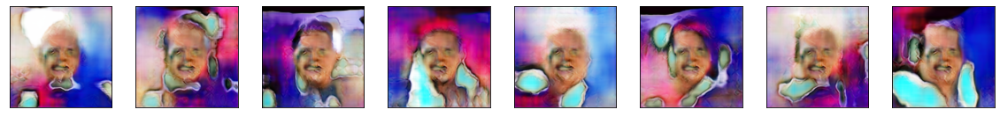

[Step 29500] D Loss: 0.1182; G Loss: 0.0000


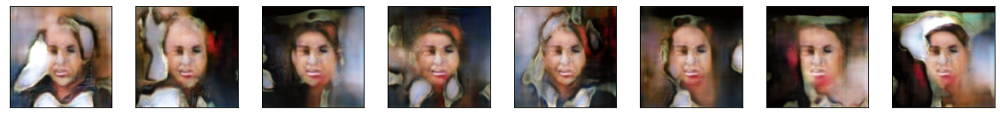

[Step 30000] D Loss: 0.3360; G Loss: 17.9081


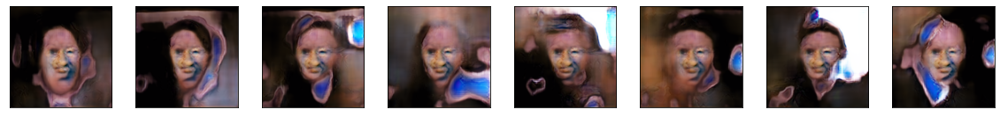

[Step 30500] D Loss: 0.0045; G Loss: 1.8650


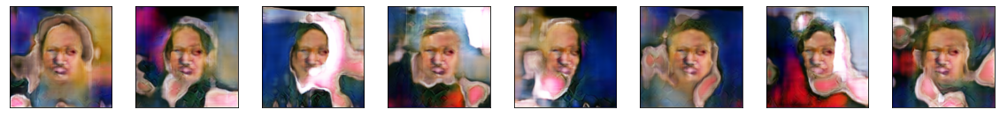

[Step 31000] D Loss: 0.0005; G Loss: 1.1463


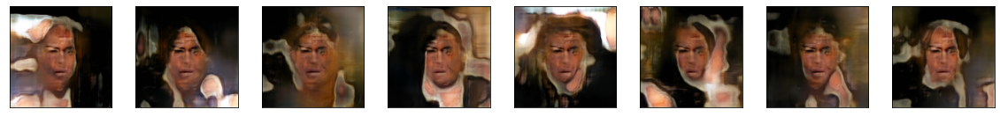

[Step 31500] D Loss: 0.1231; G Loss: 13.6651


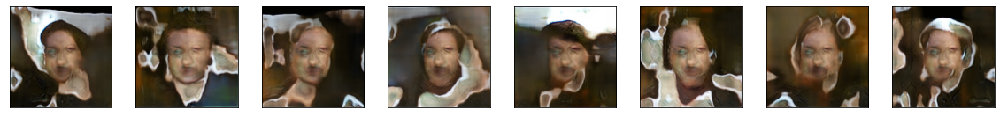

[Step 32000] D Loss: 0.0253; G Loss: 0.7413


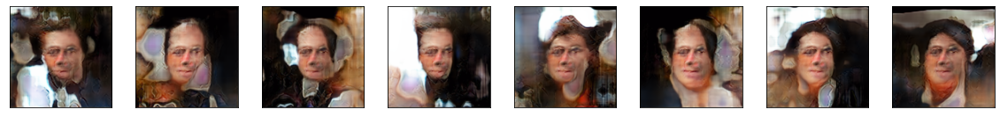

[Step 32500] D Loss: 0.4754; G Loss: 17.1044


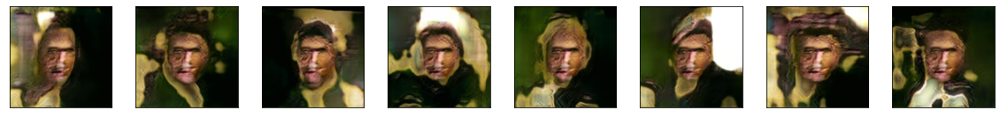

[Step 33000] D Loss: 0.0005; G Loss: 11.7264


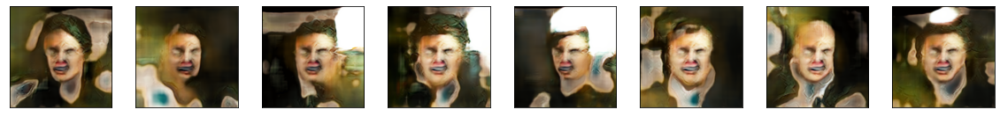

[Step 33500] D Loss: 0.0014; G Loss: 31.6602


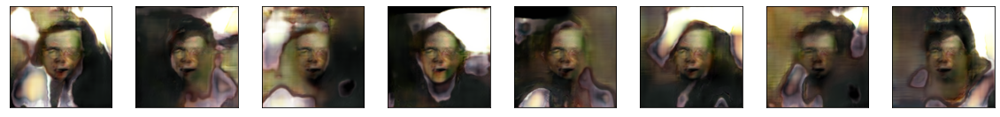

[Step 34000] D Loss: 0.5258; G Loss: 2.3072


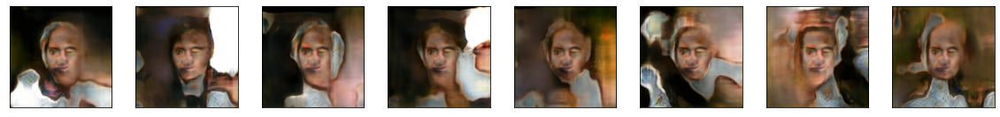

[Step 34500] D Loss: 0.8751; G Loss: 3.6338


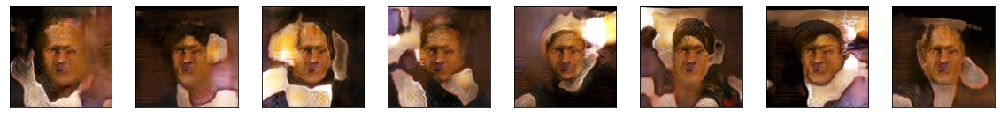

[Step 35000] D Loss: 0.0021; G Loss: 1.8954


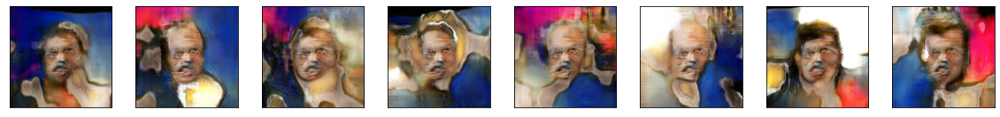

[Step 35500] D Loss: 0.3000; G Loss: 16.1989


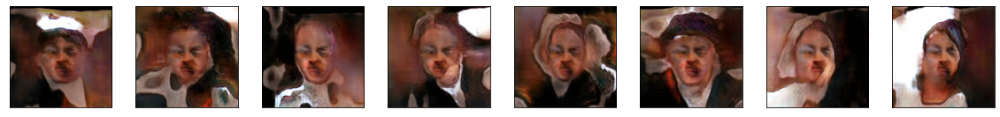

[Step 36000] D Loss: 0.2317; G Loss: 18.9422


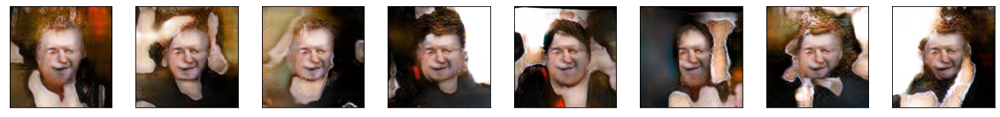

[Step 36500] D Loss: 0.0000; G Loss: 18.4991


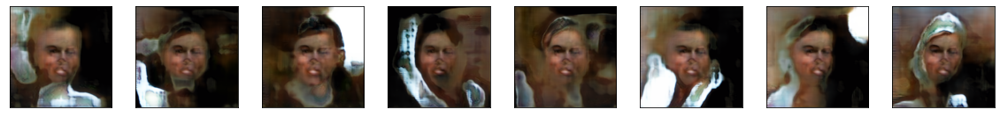

[Step 37000] D Loss: 0.0150; G Loss: 16.9124


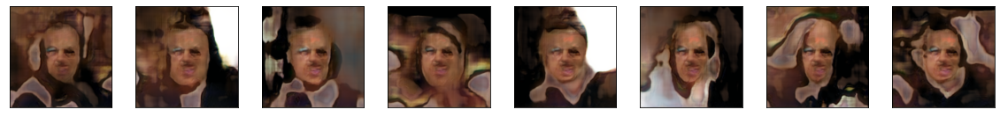

[Step 37500] D Loss: 0.0152; G Loss: 0.0000


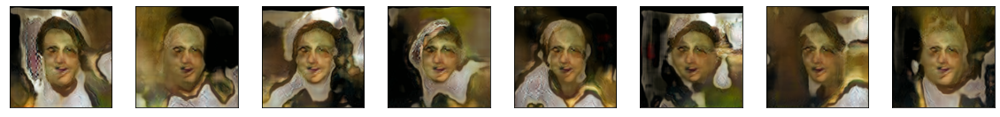

[Step 38000] D Loss: 0.1742; G Loss: 0.0000


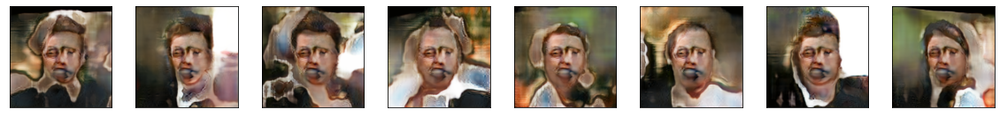

[Step 38500] D Loss: 0.6967; G Loss: 0.5054


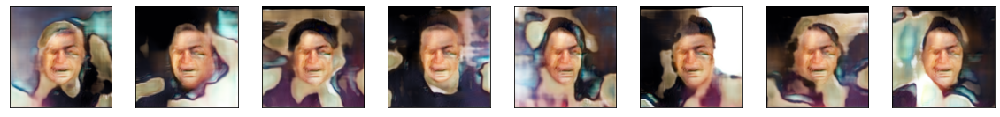

[Step 39000] D Loss: 1.5371; G Loss: 23.9334


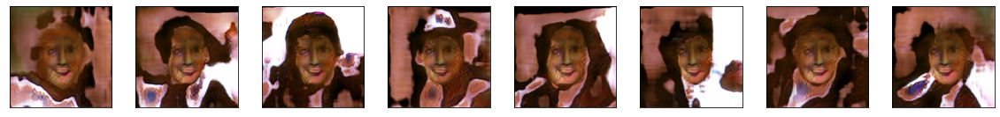

[Step 39500] D Loss: 0.0000; G Loss: 0.0000


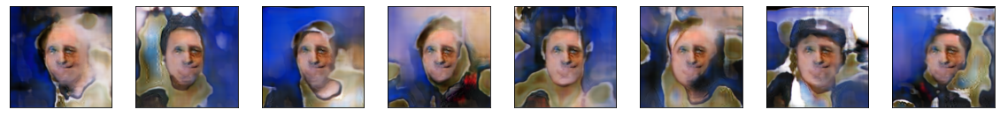

[Step 40000] D Loss: 0.0018; G Loss: 11.2285


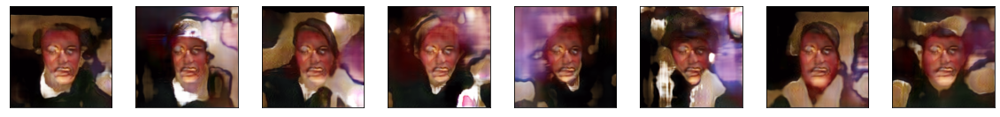

[Step 40500] D Loss: 0.2606; G Loss: 0.0434


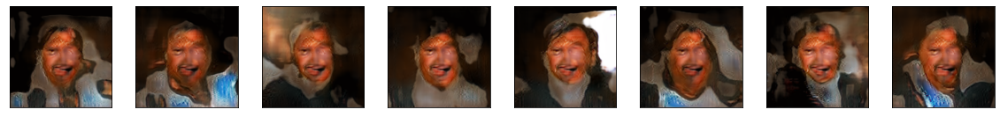

[Step 41000] D Loss: 0.3009; G Loss: 20.5722


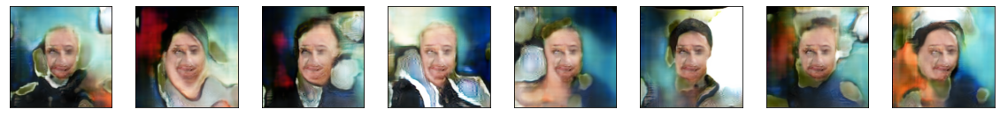

CPU times: user 2h 12min 51s, sys: 24min 28s, total: 2h 37min 19s
Wall time: 5h 44min 4s


In [21]:
%%time
for step, true_images in enumerate(train_ds):
    
    # Train Discriminator
    
    noise = np.random.normal(0, 1, (HALF_BATCH_SIZE, INPUT_DIM)).astype(np.float32)
    syntetic_images = generator.predict(noise)
    x_combined = np.concatenate((
        true_images, 
        syntetic_images))
    y_combined = np.concatenate((
        np.ones((HALF_BATCH_SIZE, 1), np.float32), 
        np.zeros((HALF_BATCH_SIZE, 1), np.float32)))
    
    with tf.GradientTape() as tape:
        logits = discriminator(x_combined, training=True)
        d_loss_value = sigmoid_cross_entropy(y_combined, logits)
    grads = tape.gradient(d_loss_value, discriminator.trainable_variables)
    optimizer.apply_gradients(zip(grads, discriminator.trainable_variables))
    
    # Train Generator
    
    noise = np.random.normal(0, 1, (BATCH_SIZE, INPUT_DIM)).astype(np.float32)
    y_mislabled = np.ones((BATCH_SIZE, 1), np.float32)
    
    with tf.GradientTape() as tape:
        syntetic = generator(noise, training=True)
        logits = discriminator(syntetic, training=False)
        g_loss_value = sigmoid_cross_entropy(y_mislabled, logits)
    grads = tape.gradient(g_loss_value, generator.trainable_variables)
    optimizer.apply_gradients(zip(grads, generator.trainable_variables))
    
    # Check intermediate results
    
    if step % 500 == 0:
        print('[Step %2d] D Loss: %.4f; G Loss: %.4f' % (
            step, d_loss_value.numpy(), g_loss_value.numpy()))
        noise = np.random.normal(0, 1, (8, INPUT_DIM)).astype(np.float32)
        syntetic_images = generator.predict(noise)
        plot_pics(syntetic_images)


## Тестирование свёрточного генератора

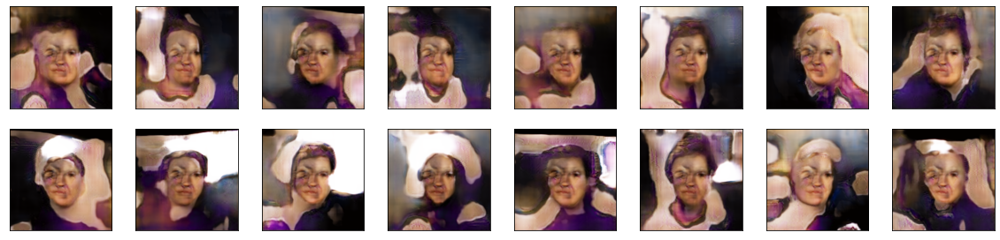

In [22]:
noise = np.random.normal(0, 1, (16, INPUT_DIM)).astype(np.float32)
syntetic_images = generator.predict(noise)
plot_pics(syntetic_images)

## Интерполяция в латентном пространстве

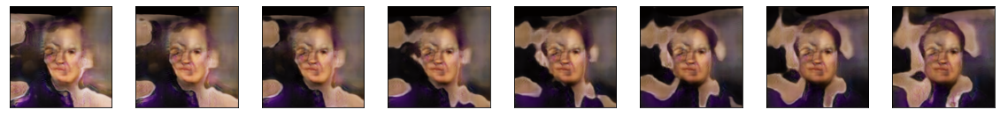

In [23]:
noise_1 = np.random.normal(0, 1, (INPUT_DIM)).astype(np.float32)
noise_2 = np.random.normal(0, 1, (INPUT_DIM)).astype(np.float32)
noise = np.linspace(noise_1, noise_2, 8)
syntetic_images = generator.predict(noise)
plot_pics(syntetic_images)